In [1]:
import numpy as np
import matplotlib.pyplot as plt

from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes
import cv2

import cv2
import matplotlib.pyplot as plt
import numpy as np
import math as m

In [1]:
def biohashing(Γ, M, m, k, τ):
    # Step 1: Generate pseudo-random vectors {ri} based on user's seed k
    np.random.seed(k)
    r = np.random.rand(m, M)
    
    # Step 2: Apply Gram-Schmidt process to transform r into an orthonormal set of matrices
    r_orthogonal = np.array([r[0]])
    for i in range(1, m):
        ri = r[i]
        for j in range(i):
            ri -= np.dot(r[i], r_orthogonal[j]) * r_orthogonal[j]
        ri /= np.linalg.norm(ri)
        r_orthogonal = np.vstack([r_orthogonal, ri])
    
    # Step 3: Compute ⟨Γ, r⊥i⟩ for each r⊥i
    inner_products = np.dot(Γ, r_orthogonal.T)
    
    # Step 4: Compute m bits BioHash {bi}
    bi = []
    for i in range(m):
        if inner_products[i] <= τ:
            bi.append(0)
        else:
            bi.append(1)
    
    return bi

# Example usage:
Γ = image_vector.copy()
M = len(Γ)
m = 20# Replace with the desired length of the protected template
k = 202211050 # Replace with the user's seed
τ = 0.4  # Replace with the preset threshold

protected_template = biohashing(Γ, M, m, k, τ)
print(protected_template)


NameError: name 'Γ' is not defined

In [3]:
def get_binary(protected_template):
    binary_vector = protected_template.copy()
    
    binary_string = ''.join(map(str, binary_vector))
    
    # Convert the binary string to decimal
    decimal_value = int(binary_string, 2)
    
    return decimal_value
# print(decimal_value)


In [4]:
import os
os.getcwd()

'C:\\Users\\yahoo\\OneDrive\\Documents\\major\\datasets'

In [5]:
os.chdir('..')

In [6]:
os.getcwd()

'C:\\Users\\yahoo\\OneDrive\\Documents\\major'

In [7]:
os.chdir('datasets\LR-VERA-fingervein')
os.getcwd()

'C:\\Users\\yahoo\\OneDrive\\Documents\\major\\datasets\\LR-VERA-fingervein'

In [8]:
import cv2
import numpy as np

k = 202211050 # Replace with the user's seed
m = 20# Replace with the desired length of the protected template
τ = 0.4  # Replace with the preset threshold

set_biohash = set()
count = 0
for folder in os.listdir():
    os.chdir(folder)
    count += 1
    k += 100
    for file_name in os.listdir():
        image = cv2.imread(file_name)
#         print(file_name)
        image_vector = image.flatten() / 255.0  # Normalize pixel values to the range [0, 1]
        # Print the vector
#         print(image_vector.tolist())  # Convert to a list for the desired forma
        
        # Example usage:
        Γ = image_vector.copy()
        M = len(Γ)
        
        biohash = biohashing(Γ, M, m, k, τ)
        print(k)
        binary_number = get_binary(biohash)
        set_biohash.add(str(binary_number))
        print(f'{file_name}: {binary_number}')
        
        break
    os.chdir('..')
    if count > 9:
        break

    # Resize the image to a specific size (e.g., 100x100 pixels)
#     width, height = 615, 149
#     resized_image = cv2.resize(image, (width, height))

    # Flatten the image into a 1D vector
#     image_vector = resized_image.flatten() / 255.0  # Normalize pixel values to the range [0, 1]

#     # Print the vector
#     print(image_vector.tolist())  # Convert to a list for the desired format


202211150
001_L_1.png: 524288
202211250
001_R_1.png: 524288
202211350
002_L_1.png: 526344
202211450
002_R_1.png: 524544
202211550
003_L_1.png: 590850
202211650
003_R_1.png: 565265
202211750
004_L_1.png: 525313
202211850
004_R_1.png: 524288
202211950
005_L_1.png: 524416
202212050
005_R_1.png: 532480


In [9]:
os.getcwd()

'C:\\Users\\yahoo\\OneDrive\\Documents\\major\\datasets\\LR-VERA-fingervein'

In [10]:
for ele in set_biohash:
    print(ele, end= ' ')

565265 526344 524544 524288 525313 524416 532480 590850 

In [11]:
os.chdir('..')
os.chdir('..')

In [12]:
os.getcwd()

'C:\\Users\\yahoo\\OneDrive\\Documents\\major'

## simple interchange

(-0.5, 251.5, 251.5, -0.5)

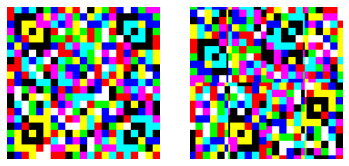

In [13]:
import cv2
import numpy as np

# Load the image

image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
image = cv2.imread(image_path)
orig_img = image.copy()

# Define the number of iterations
iterations = 10

# Perform the operations for each iteration
for i in range(iterations):
    # Divide the image into 4 equal parts
    height, width, channels = image.shape
    half_height = height // 2
    half_width = width // 2

    first_quarter = image[:half_height, :half_width]
    second_quarter = image[:half_height, half_width:]
    third_quarter = image[half_height:, :half_width]
    fourth_quarter = image[half_height:, half_width:]

    # Interchange the quarters
    new_image = np.vstack((second_quarter, first_quarter, fourth_quarter, third_quarter))

    # Rotate the image 90 degrees
    image = cv2.rotate(new_image, cv2.ROTATE_90_CLOCKWISE)

    # Display the intermediate result (optional)
#     cv2.imshow(f'Iteration {i+1}', image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

# Save the final result
# cv2.imwrite('final_image.png', image)

# Display the final result (optional)
# cv2.imshow('Final Image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

plt.subplot(121)
plt.imshow(orig_img)
plt.axis('off')

plt.subplot(122)
plt.imshow(image)
plt.axis('off')

## xor

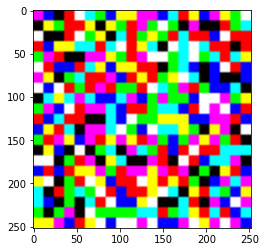

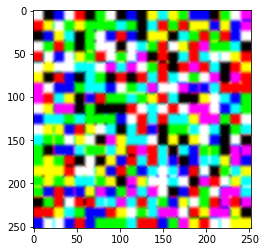

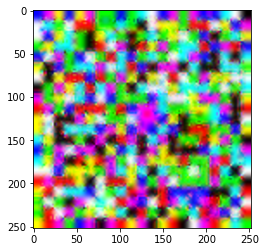

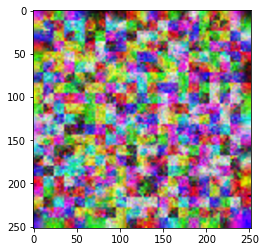

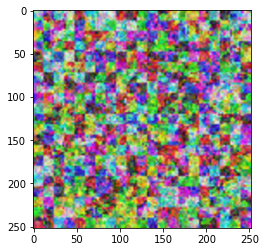

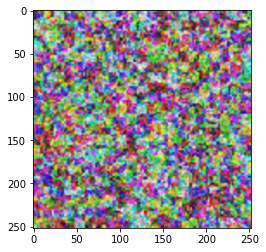

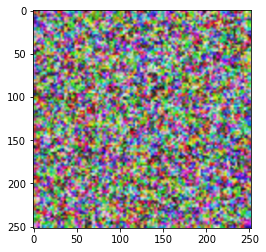

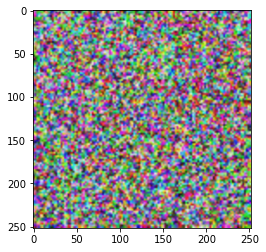

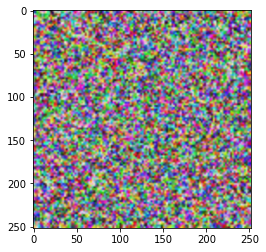

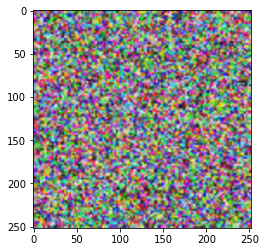

In [14]:
import cv2
import numpy as np

# Load the initial image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
original_image = cv2.imread(image_path)

# Define the number of iterations
num_iterations = 10

# Iterate through the desired number of iterations
for iteration in range(num_iterations):
    # Divide the image into 4 equal parts vertically
    height, width, _ = original_image.shape
    half_height = height // 2

    # Split the image into 4 parts
    part1 = original_image[:half_height, :]
    part2 = original_image[half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result1 = cv2.bitwise_xor(part1, part2)
    
    # Rotate the image by 90 degrees
    rotated_image = cv2.rotate(result1, cv2.ROTATE_90_CLOCKWISE)

    # Divide the rotated image into 4 equal parts vertically
    rotated_height, rotated_width, _ = rotated_image.shape
    rotated_half_height = rotated_height // 2

    # Split the rotated image into 4 parts
    rotated_part1 = rotated_image[:rotated_half_height, :]
    rotated_part2 = rotated_image[rotated_half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result2 = cv2.bitwise_xor(rotated_part1, rotated_part2)

    # Rotate the result by 90 degrees
    final_result = cv2.rotate(result2, cv2.ROTATE_90_CLOCKWISE)

    # Increase each pixel by 4
    final_result = cv2.add(final_result, 4)

    # Resize the result back to the original dimensions
    final_result = cv2.resize(final_result, (width, height))

    # Display the image for this iteration
#     cv2.imshow(f'Iteration {iteration + 1}', final_result)

    # Update the original image for the next iteration
    original_image = final_result

    plt.imshow(original_image)
    plt.show()

## XOR with median filtering

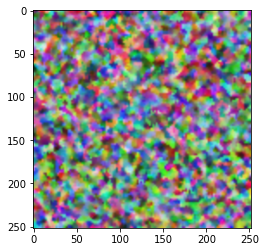

In [15]:
import cv2
import numpy as np

# Load the initial image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
original_image = cv2.imread(image_path)

# Define the number of iterations
num_iterations = 10

# Iterate through the desired number of iterations
for iteration in range(num_iterations):
    # Divide the image into 4 equal parts vertically
    height, width, _ = original_image.shape
    half_height = height // 2

    # Split the image into 4 parts
    part1 = original_image[:half_height, :]
    part2 = original_image[half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result1 = cv2.bitwise_xor(part1, part2)
    
    # Rotate the image by 90 degrees
    rotated_image = cv2.rotate(result1, cv2.ROTATE_90_CLOCKWISE)

    # Divide the rotated image into 4 equal parts vertically
    rotated_height, rotated_width, _ = rotated_image.shape
    rotated_half_height = rotated_height // 2

    # Split the rotated image into 4 parts
    rotated_part1 = rotated_image[:rotated_half_height, :]
    rotated_part2 = rotated_image[rotated_half_height:, :]

    # XOR operation between the 1st and 2nd part, and the 3rd and 4th part
    result2 = cv2.bitwise_xor(rotated_part1, rotated_part2)

    # Rotate the result by 90 degrees
    final_result = cv2.rotate(result2, cv2.ROTATE_90_CLOCKWISE)

    # Increase each pixel by a smaller value (e.g., 2 instead of 4)
    final_result = cv2.add(final_result, 2)

    # Apply median filtering to reduce noise
    final_result = cv2.medianBlur(final_result, 3)  # Adjust kernel size as needed

    # Resize the result back to the original dimensions
    final_result = cv2.resize(final_result, (width, height))

    # Display the image for this iteration
#     cv2.imshow(f'Iteration {iteration + 1}', final_result)

    # Update the original image for the next iteration
    original_image = final_result
    
    plt.imshow(original_image)
  
    folder_path = 'C:\\Users\\yahoo\\OneDrive\\Documents\\major\\datasets\\Transformation\\User 1'
    file_name = 'user1_plot.png'

# Check if the folder exists, and if not, create it
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)

# Now, you can save the image to the specified folder
    full_file_path = os.path.join(folder_path, file_name)
    plt.savefig(full_file_path)
    # Exit the loop when the user presses a key
#     if cv2.waitKey(0) & 0xFF == 27:  # Press 'Esc' key to exit
#         break
    
# cv2.destroyAllWindows()


In [16]:
pip install keras


Note: you may need to restart the kernel to use updated packages.


In [17]:
pip install tensorflow


Note: you may need to restart the kernel to use updated packages.


In [18]:
# Importing necessary functions
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import array_to_img, img_to_array, load_img
  
# Initialising the ImageDataGenerator class.
# We will pass in the augmentation parameters in the constructor.
datagen = ImageDataGenerator(
        rotation_range = 40,
        shear_range = 0.2,
        zoom_range = 0.2,
        horizontal_flip = True,
        brightness_range = (0.5, 1.5))
   
# Loading a sample image 
img = load_img('C:\\Users\\yahoo\\OneDrive\\Documents\\major\datasets\\Transformation\\User 1\\user1_plot.png') 
# Converting the input sample image to an array
x = img_to_array(img)
# Reshaping the input image
x = x.reshape((1, ) + x.shape) 
  
# Generating and saving 5 augmented samples 
# using the above defined parameters. 
i = 0
for batch in datagen.flow(x, batch_size = 1,
                          save_to_dir ='C:\\Users\\yahoo\\OneDrive\\Documents\\major\datasets\\Transformation\\User 1', 
                          save_prefix ='image', save_format ='jpeg'):
    i += 1
    if i > 5:
        break


## aes with increase pixel

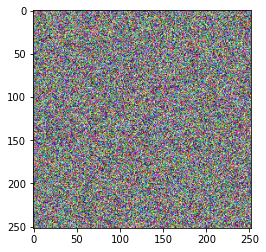

In [19]:
from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes
import cv2
import numpy as np

# Load the image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
image = cv2.imread(image_path)

# Define the number of iterations
iterations = 10

# Function to perform AES encryption and decryption
def aes_encrypt_decrypt(data, key):
    cipher = AES.new(key, AES.MODE_EAX)
    encrypted_data, tag = cipher.encrypt_and_digest(data)
    return encrypted_data, cipher.nonce

def aes_decrypt(data, key, nonce):
    cipher = AES.new(key, AES.MODE_EAX, nonce=nonce)
    decrypted_data = cipher.decrypt(data)
    return decrypted_data

# Perform the operations for each iteration
for i in range(iterations):
    # Divide the image into 4 equal parts
    height, width, channels = image.shape
    half_height = height // 2
    half_width = width // 2

    first_quarter = image[:half_height, :half_width]
    second_quarter = image[:half_height, half_width:]
    third_quarter = image[half_height:, :half_width]
    fourth_quarter = image[half_height:, half_width:]

    # AES encrypt the quarters
    encryption_key = get_random_bytes(16)
    encrypted_first = aes_encrypt_decrypt(first_quarter.tobytes(), encryption_key)[0]
    encrypted_second = aes_encrypt_decrypt(second_quarter.tobytes(), encryption_key)[0]
    encrypted_third = aes_encrypt_decrypt(third_quarter.tobytes(), encryption_key)[0]
    encrypted_fourth = aes_encrypt_decrypt(fourth_quarter.tobytes(), encryption_key)[0]

    # Combine the encrypted quarters
    new_image = np.vstack((np.frombuffer(encrypted_second, dtype=np.uint8).reshape(second_quarter.shape),
                           np.frombuffer(encrypted_first, dtype=np.uint8).reshape(first_quarter.shape),
                           np.frombuffer(encrypted_fourth, dtype=np.uint8).reshape(fourth_quarter.shape),
                           np.frombuffer(encrypted_third, dtype=np.uint8).reshape(third_quarter.shape)))

    # Rotate the image 90 degrees
    image = cv2.rotate(new_image, cv2.ROTATE_90_CLOCKWISE)

    # Display the intermediate result (optional)
#     cv2.imshow(f'Iteration {i + 1}', image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()
    plt.imshow(original_image)

# Save the final result
cv2.imwrite('final_image.png', image)

# # Display the final result (optional)
# cv2.imshow('Final Image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
plt.imshow(image)

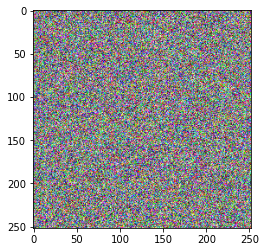

In [20]:
# Load the image
image_path = 'datasets\jabcode\jabcode_user_1.png'
image = cv2.imread(image_path)

# Define the number of iterations
iterations = 10

# Function to perform AES encryption and decryption
def aes_encrypt_decrypt(data, key):
    cipher = AES.new(key, AES.MODE_EAX)
    encrypted_data, tag = cipher.encrypt_and_digest(data)
    return encrypted_data, cipher.nonce

def aes_decrypt(data, key, nonce):
    cipher = AES.new(key, AES.MODE_EAX, nonce=nonce)
    decrypted_data = cipher.decrypt(data)
    return decrypted_data

# Perform the operations for each iteration
for i in range(iterations):
    # Divide the image into 4 equal parts
    height, width, channels = image.shape
    half_height = height // 2
    half_width = width // 2

    first_quarter = image[:half_height, :half_width]
    second_quarter = image[:half_height, half_width:]
    third_quarter = image[half_height:, :half_width]
    fourth_quarter = image[half_height:, half_width:]

    # AES encrypt the quarters
    encryption_key = get_random_bytes(16)
    encrypted_first = aes_encrypt_decrypt(first_quarter.tobytes(), encryption_key)[0]
    encrypted_second = aes_encrypt_decrypt(second_quarter.tobytes(), encryption_key)[0]
    encrypted_third = aes_encrypt_decrypt(third_quarter.tobytes(), encryption_key)[0]
    encrypted_fourth = aes_encrypt_decrypt(fourth_quarter.tobytes(), encryption_key)[0]

    # Combine the encrypted quarters
    new_image = np.vstack((np.frombuffer(encrypted_second, dtype=np.uint8).reshape(second_quarter.shape),
                           np.frombuffer(encrypted_first, dtype=np.uint8).reshape(first_quarter.shape),
                           np.frombuffer(encrypted_fourth, dtype=np.uint8).reshape(fourth_quarter.shape),
                           np.frombuffer(encrypted_third, dtype=np.uint8).reshape(third_quarter.shape)))

    # Rotate the image 90 degrees
    image = cv2.rotate(new_image, cv2.ROTATE_90_CLOCKWISE)

    # Increase pixel values by 4
    image = np.clip(image.astype(int) + 4, 0, 255).astype(np.uint8)

    # Display the intermediate result (optional)
#     cv2.imshow(f'Iteration {i + 1}', image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

# Save the final result
cv2.imwrite('final_image.png', image)

# Display the final result (optional)
# cv2.imshow('Final Image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
plt.imshow(image)

## biocube

In [21]:
def infinte_cube_XOR(img):
    ''' Perform atomic operations on image similar to infinity cube. On performing these steps 'n' times, we can generate the biometric template.
        Input:
            img: The input image
        Output:
            returns the image after performing atomic operation once
    '''
    # Make width dimension even, if it is not
    if img.shape[1]%2 != 0:
        img = img[:, 0:img.shape[1]-1, :]    

    # Expand horizontally
    new_img = cv2.resize(img, (2*img.shape[1], img.shape[0]))

    # Make the height and width of even number
    if new_img.shape[0]%2 != 0:
        new_img = new_img[0:-2, :, :]
    if new_img.shape[1]%2 != 0:
        new_img = new_img[:, 0:-2, :]
#     plt.imshow(new_img)
#     plt.show()
#     new_img.shape

    # Split image vertically into top image and bottom image
    height, width, channels = new_img.shape
    half_height = height//2

    top_img, bottom_img = new_img[:half_height, :], new_img[half_height:, :]

#     plt.imshow(top_img)
#     plt.show()
#     plt.imshow(bottom_img)
#     plt.show()
#     top_img.shape, bottom_img.shape

    # Perform XOR operation between top and bottom section of images
    XOR_img = np.bitwise_xor(top_img, bottom_img)

#     plt.imshow(XOR_img)

    # Split image into 4 equal parts
    height, width, channels = XOR_img.shape
    quarter_width = width//4
    if width%4 != 0:
        quarter_width = int(width//4)
        XOR_img = XOR_img[:, 1:XOR_img.shape[1]-1, :]

    img1, img2, img3, img4 = XOR_img[:, 0:quarter_width], XOR_img[:, quarter_width: 2*quarter_width], XOR_img[:, 2*quarter_width:3*quarter_width], XOR_img[:, 3*quarter_width:]

#     plt.imshow(img1)
#     plt.show()
#     plt.imshow(img2)
#     plt.show()
#     plt.imshow(img3)
#     plt.show()
#     plt.imshow(img4)
#     plt.show()

    # Create new top and bottom images by merging middle two images and two outermost images respectively 
    top_img = cv2.hconcat([img2, img3])
    bottom_img = cv2.hconcat([img1, img4])

#     plt.imshow(top_img)
#     plt.show()
#     plt.imshow(bottom_img)
#     plt.show()
    
    # Form the image of originaly shape by concatenating the two images vertically
#     print(top_img.shape)
#     print(bottom_img.shape)
    new_img = cv2.vconcat([top_img, bottom_img])

#     plt.imshow(new_img)
#     new_img.shape
    
    # Expand vertically
    new_img = cv2.resize(new_img, (new_img.shape[1], 2*new_img.shape[0]))

#     plt.imshow(new_img)
#     plt.show()
#     new_img.shape

    # Split image horizontally into left image and right image
    height, width, channels = new_img.shape
    half_width = width//2

    left_img, right_img = new_img[:, :half_width], new_img[:, half_width:]

#     plt.imshow(left_img)
#     plt.show()
#     plt.imshow(right_img)
#     plt.show()
#     left_img.shape, right_img.shape

    # Perform XOR operation between left and right section of images
    XOR_img = np.bitwise_xor(left_img, right_img)

#     plt.imshow(XOR_img)

    # Split image into 4 equal parts
    height, width, channels = XOR_img.shape
    quarter_height = height//4

    img1, img2, img3, img4 = XOR_img[0:quarter_height, :], XOR_img[quarter_height:2*quarter_height, :], XOR_img[2*quarter_height:3*quarter_height, :], XOR_img[3*quarter_height:, :]

#     plt.imshow(img1)
#     plt.show()
#     plt.imshow(img2)
#     plt.show()
#     plt.imshow(img3)
#     plt.show()
#     plt.imshow(img4)
#     plt.show()

    # Create new left and right images by merging middle two images and two outermost images respectively 
    left_img = cv2.vconcat([img2, img3])
    right_img = cv2.vconcat([img1, img4])

#     plt.imshow(left_img)
#     plt.show()
#     plt.imshow(right_img)
#     plt.show()

    # Form the image of originaly shape by concatenating the two images vertically
    new_img = cv2.hconcat([left_img, right_img])
#     plt.imshow(new_img)
#     new_img.shape

    return new_img

In [22]:
import os
os.chdir('..')
os.getcwd()

'C:\\Users\\yahoo\\OneDrive\\Documents'

(252, 252, 3)

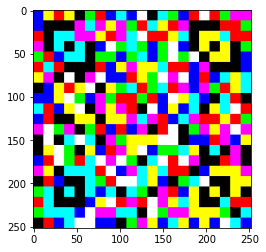

In [23]:
# Load image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
img.shape

## ADDING LAPLACIAN FILTERS

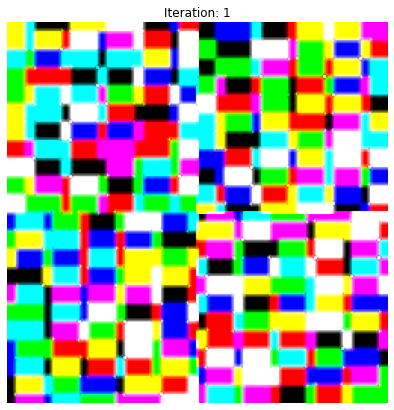

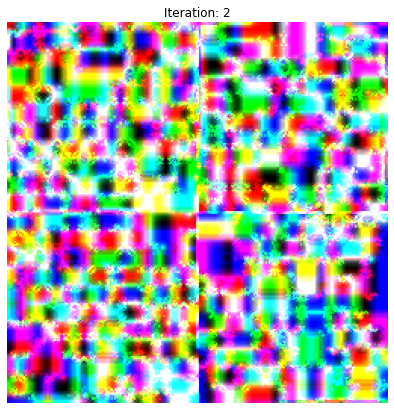

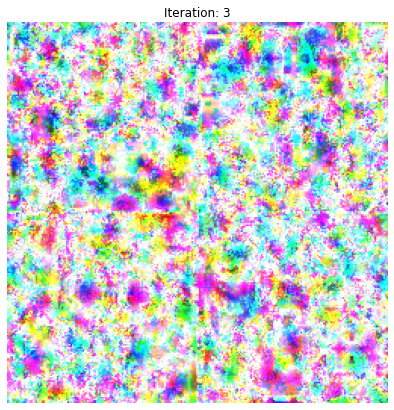

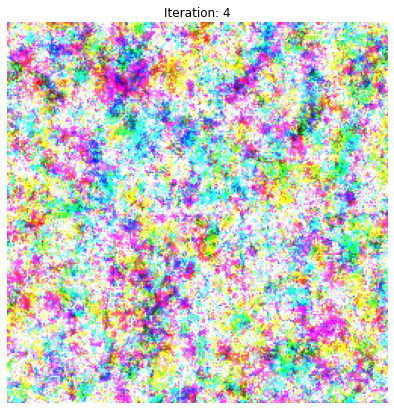

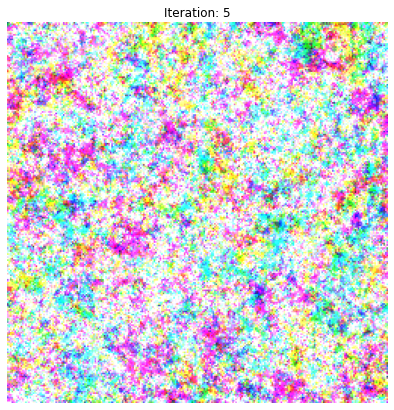

...

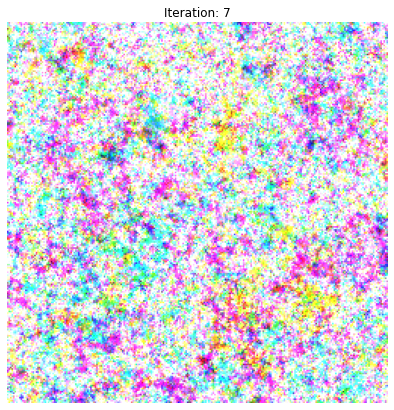

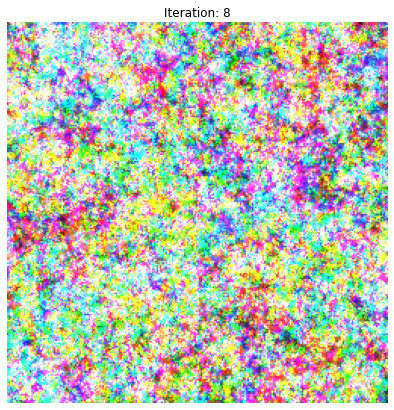

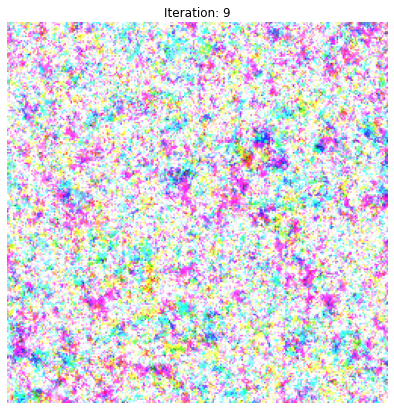

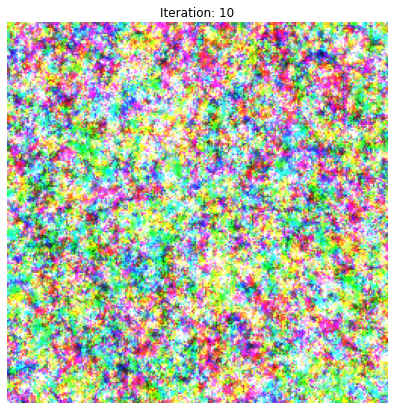

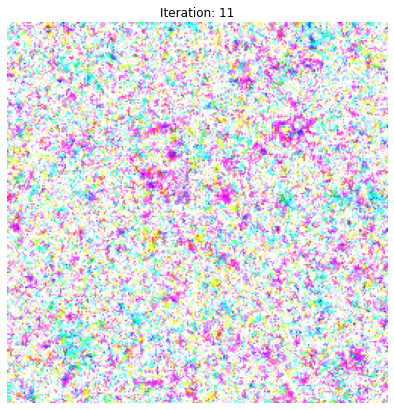

In [26]:
import cv2

def add_laplacian_filter(img):
    laplacian = cv2.Laplacian(img, cv2.CV_64F)
    laplacian = cv2.convertScaleAbs(laplacian)
    return cv2.add(img, laplacian)

# Load image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
template1 = img.copy()

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        template1 = add_laplacian_filter(template1)

        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)


## both blur and sharping filters

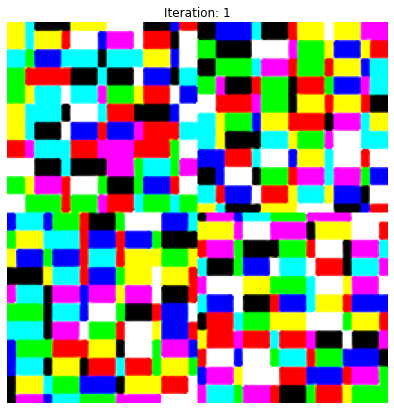

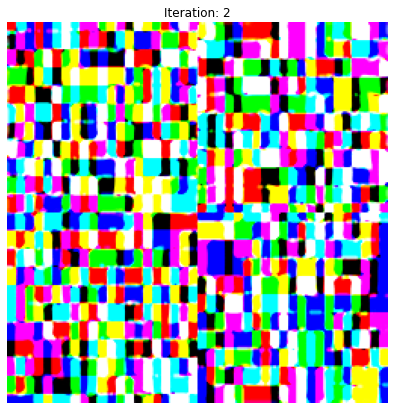

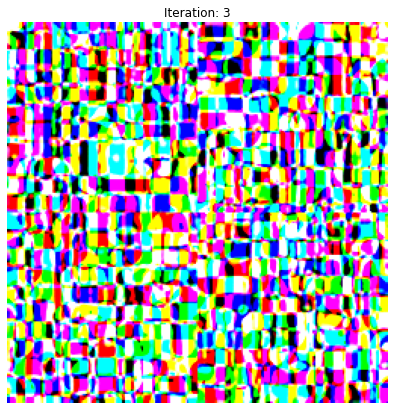

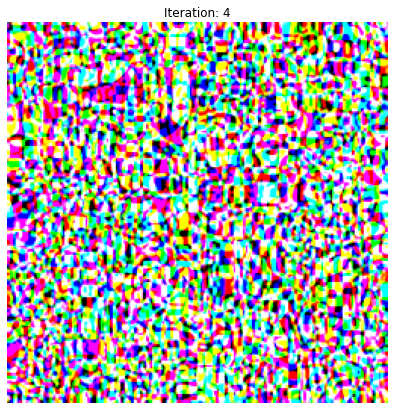

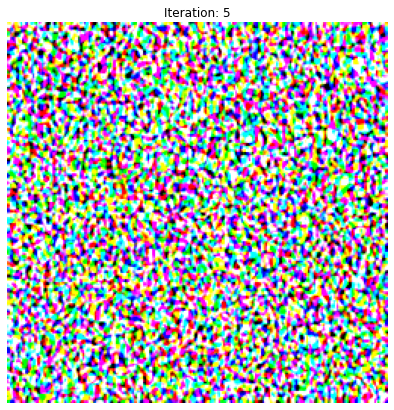

...

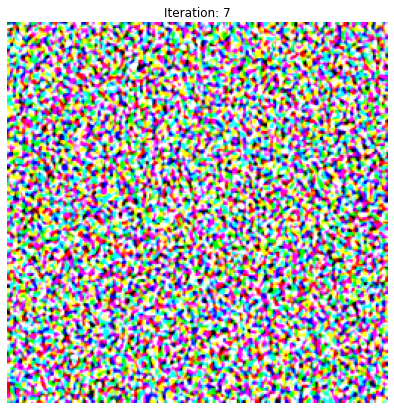

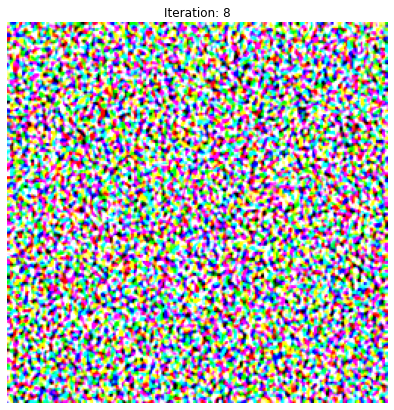

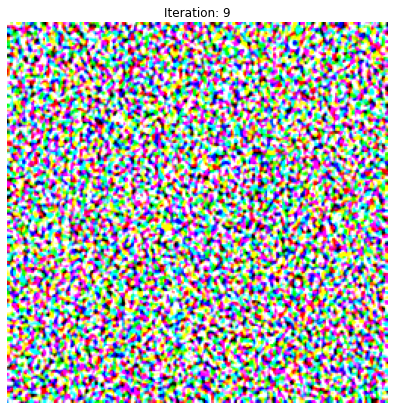

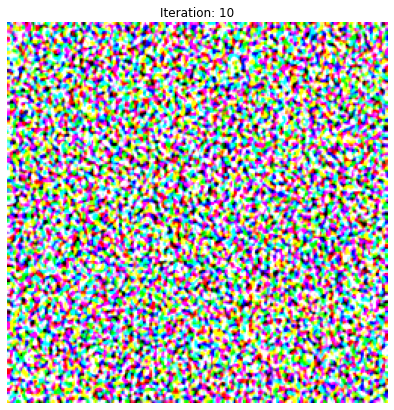

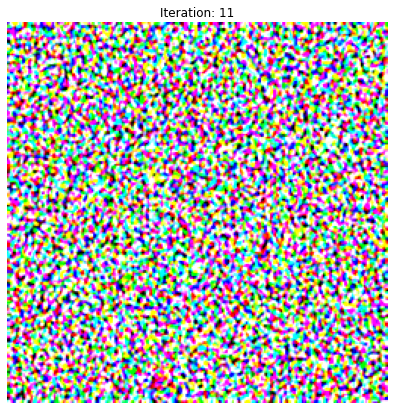

In [27]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def enhance_image(img):
    # Apply Gaussian blur to reduce noise
    blurred_img = cv2.GaussianBlur(img, (5, 5), 0)

    # Apply contrast enhancement
    alpha = 1.5  # You can adjust this value to control contrast
    enhanced_img = cv2.convertScaleAbs(blurred_img, alpha=alpha, beta=0)

    # Apply sharpening
    kernel = np.array([[-1, -1, -1],
                       [-1,  9, -1],
                       [-1, -1, -1]])
    sharpened_img = cv2.filter2D(enhanced_img, -1, kernel)

    return sharpened_img

# Load image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
template1 = img.copy()

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        template1 = enhance_image(template1)

        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)


## bILITERAL FILTERS

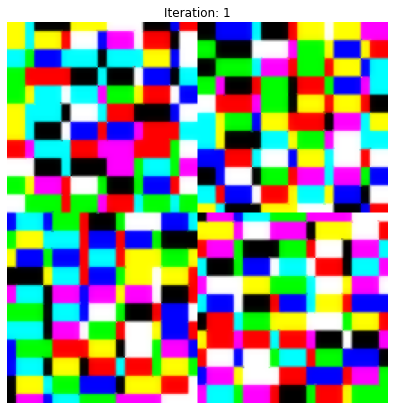

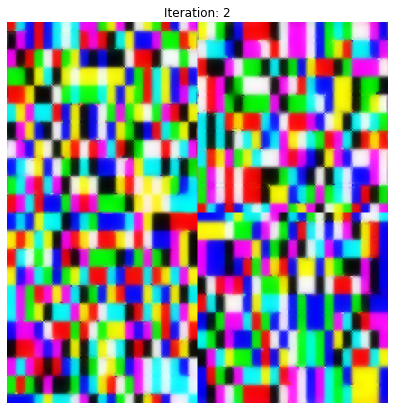

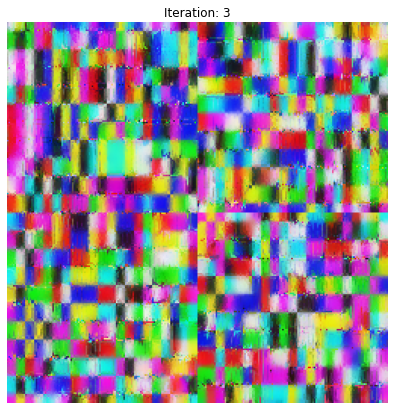

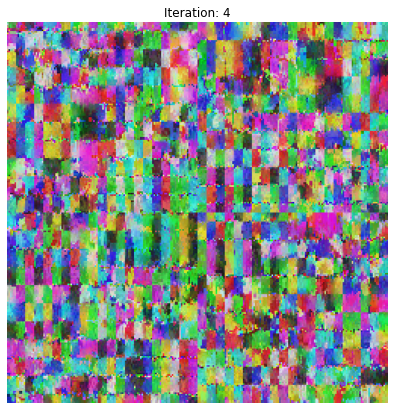

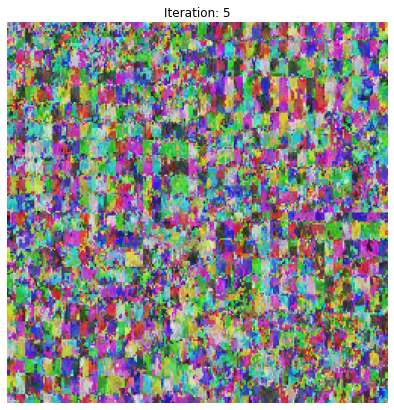

...

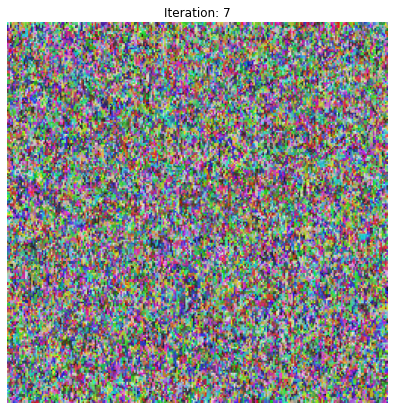

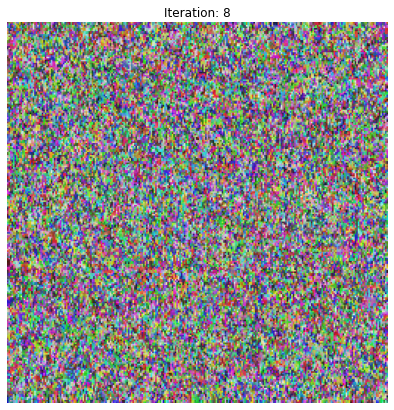

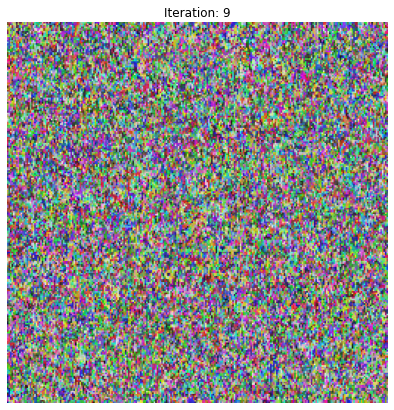

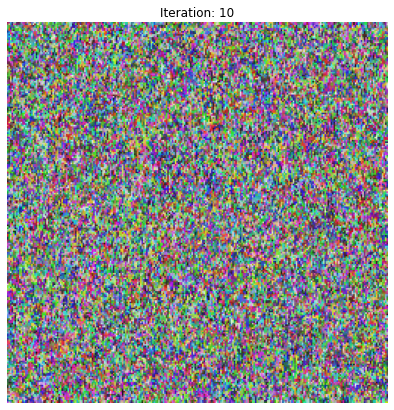

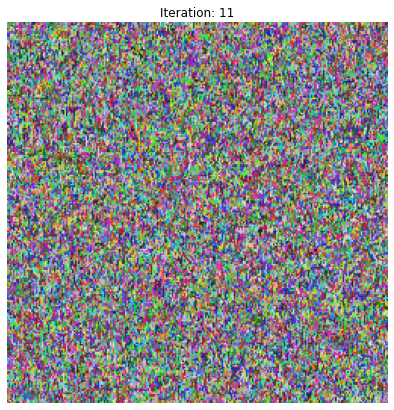

In [28]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def enhance_image(img):
    # Apply the Bilateral Filter
    enhanced_img = cv2.bilateralFilter(img, d=9, sigmaColor=75, sigmaSpace=75)

    return enhanced_img

# Load image
image_path = 'C:/Users/yahoo/OneDrive/Documents/major/datasets/Jabcode/jabcode_user_1.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
template1 = img.copy()

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        template1 = enhance_image(template1)

        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)


In [32]:
pip install tensorflow-hub


Note: you may need to restart the kernel to use updated packages.


## TRYING WITH CNN NETWORKS


255
0


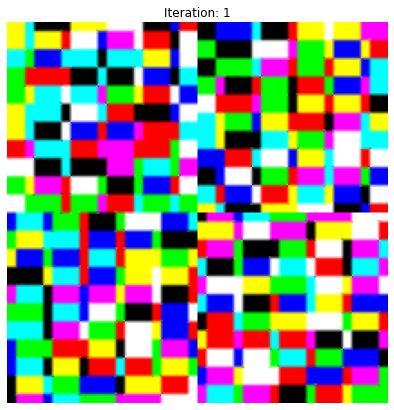

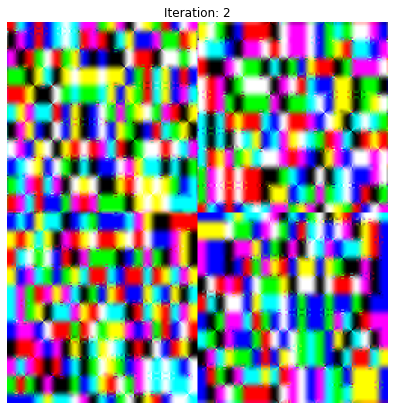

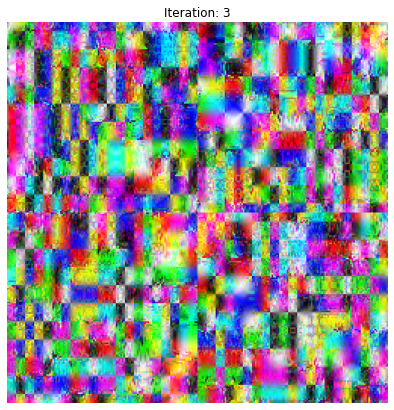

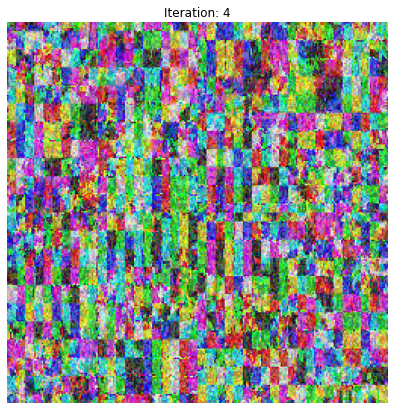

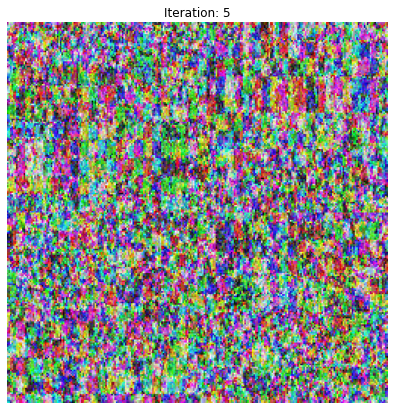

...

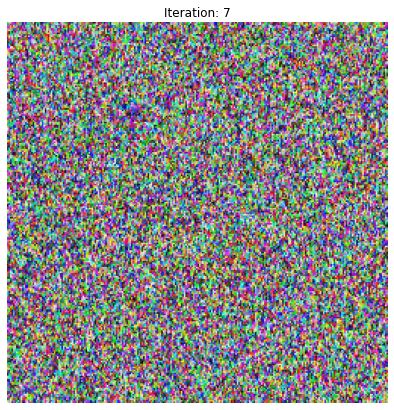

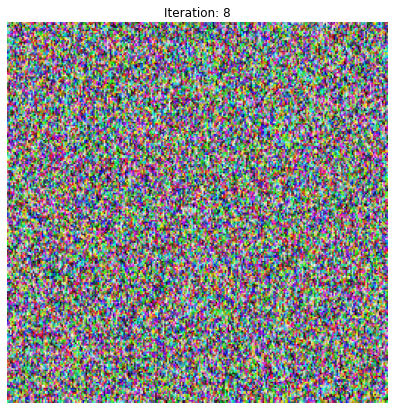

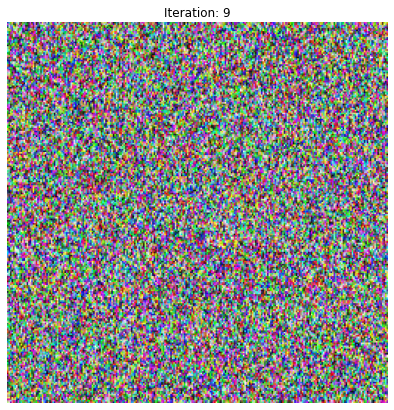

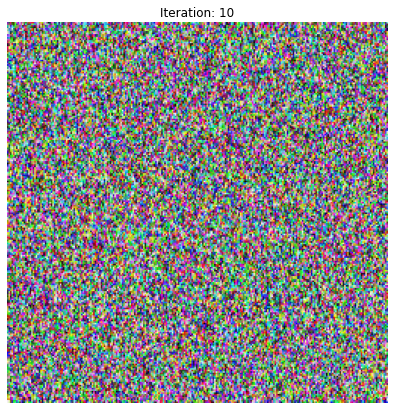

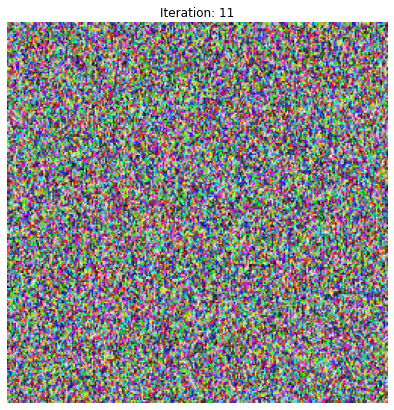

In [24]:
template1 = img.copy()

print(template1.max())
print(template1.min())

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)


In [25]:
# Load image
image_path = 'datasets\qrcode\qr-code.png'
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
img.shape

template1 = img.copy()

print(template1.max())
print(template1.min())

for cnt in range(100):
    if cnt <= 10:
        template1 = infinte_cube_XOR(template1)
        plt.figure(figsize=(10, 7))
        
        tmp_max = template1.max()
        tmp_min = template1.min()
        disp_img = (template1 - tmp_min) / (tmp_max - tmp_min)
        
        plt.imshow(disp_img)
        plt.title(f'Iteration: {cnt+1}')
        plt.axis('off')
        filename = f'iteration_{cnt+1}.png'
        plt.savefig(filename)


error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cv::cvtColor'


# APPLYING GAN 

In [2]:
import os
import cv2
import numpy as np

# Define the path to the folder containing your JAB code images
jabcode_folder = r'C:\Users\yahoo\OneDrive\Documents\major\datasets\Jabcode'

# Define the output folder for augmented data
output_folder = r'C:\Users\yahoo\OneDrive\Documents\major\datasets\augmented_data'

# Ensure the output folder exists, create it if it doesn't
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Function to create augmented images
def augment_image(image, output_folder, user_id, num_augmentations=10):
    for i in range(num_augmentations):
        augmented_image = image.copy()
        
        # Apply data augmentation here
        # Example: Rotate the image by a random angle
        angle = np.random.uniform(-10, 10)  # Adjust the range as needed
        rows, cols, _ = augmented_image.shape
        M = cv2.getRotationMatrix2D((cols / 2, rows / 2), angle, 1)
        augmented_image = cv2.warpAffine(augmented_image, M, (cols, rows))
        
        # Save the augmented image to the user's folder
        output_filename = f'jabcode_user_{user_id}_augmented_{i}.png'
        output_path = os.path.join(output_folder, output_filename)
        cv2.imwrite(output_path, augmented_image)

# Loop through the JAB code files and apply data augmentation
for filename in os.listdir(jabcode_folder):
    if filename.endswith('.png'):
        user_id = int(filename.split('_')[-1].split('.')[0])
        user_folder = os.path.join(output_folder, f'user_{user_id}')
        if not os.path.exists(user_folder):
            os.makedirs(user_folder)
        
        image_path = os.path.join(jabcode_folder, filename)
        image = cv2.imread(image_path)
        
        # Apply data augmentation for each image
        augment_image(image, user_folder, user_id, num_augmentations=10)

print("Data augmentation completed.")


Data augmentation completed.


# Applying Conditional Gan

In [7]:
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import os
from tensorflow.keras.optimizers import Adam
import cv2
def build_cgan():
    # Generator network
    generator = models.Sequential()
    user_id_float = layers.Lambda(lambda x: tf.cast(x, tf.float32))(user_id_input)
    concatenated_inputs = tf.concat([user_id_float, noise_input], axis=1)  # Concatenate user ID and noise
    generator.add(layers.Dense(256, activation='relu', input_dim=101))  # 101 is the total dimension after concatenation
    generator.add(layers.Reshape((7, 7, 8)))
    generator.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', activation='relu'))
    generator.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', activation='relu'))
    generator.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', activation='tanh'))

    # Discriminator network
    discriminator = models.Sequential()
    discriminator.add(layers.Input(shape=(252, 252, 1)))
    discriminator.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', activation='relu'))
    discriminator.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same', activation='relu'))
    discriminator.add(layers.Flatten())
    discriminator.add(layers.Dense(1, activation='sigmoid'))

    return generator, discriminator


# Define user ID and noise input layers
user_id_input = layers.Input(shape=(1,), dtype=tf.int32)
noise_input = layers.Input(shape=(100,))

# Create cGAN model
generator, discriminator = build_cgan()

# Define loss functions and optimizers for generator and discriminator
cross_entropy = tf.keras.losses.BinaryCrossentropy()

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = Adam(1e-4)
discriminator_optimizer = Adam(1e-4)
# Define constants
BATCH_SIZE = 64
EPOCHS = 100
NUM_USERS = 10

# Training loop
@tf.function
def train_step(images, user_ids):
    noise = tf.random.normal([BATCH_SIZE, 100])
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator([user_ids, noise], training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

# Load your augmented data and user IDs here
# Define the path to the augmented data folder
augmented_data_folder = r'C:\Users\yahoo\OneDrive\Documents\major\datasets\augmented_data'

# Define the number of users and the number of images per user
NUM_USERS = 10
NUM_IMAGES_PER_USER = 10

# Initialize empty lists to store user data and user IDs
user_data = []
user_ids = []

# Loop through the folders for each user
for user_id in range(1, NUM_USERS + 1):
    user_data_folder = os.path.join(augmented_data_folder, f'user_{user_id}')
    
    user_images = []  # To store images for the current user
    user_id_array = np.array([user_id] * NUM_IMAGES_PER_USER, dtype=np.int32)  # User IDs for the current user
    
    for image_id in range(NUM_IMAGES_PER_USER):
        image_filename = f'jabcode_user_{user_id}_augmented_{image_id}.png'
        image_path = os.path.join(user_data_folder, image_filename)
        
        # Load and preprocess the image
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale image
        image = cv2.resize(image, (252, 252))  # Resize if needed
        
        user_images.append(image)
    
    user_data.append(user_images)
    user_ids.append(user_id_array)

# Now you have user_data, a list of lists containing user-specific images, and user_ids, a list of user IDs corresponding to each user's images.

# You can use these arrays to train your cGAN.

# Assuming you have already loaded and organized your data as user_data and user_ids

# Create a user ID to condition mapping
user_ids_mapping = {}
for i in range(NUM_USERS):
    user_ids_mapping[i] = np.array([i] * BATCH_SIZE, dtype=np.int32)

# Main training loop
for epoch in range(EPOCHS):
    for user_id in range(NUM_USERS):
        for batch_images in user_data[user_id]:
            train_step(batch_images, user_ids_mapping[user_id])


ValueError: Exception encountered when calling layer "reshape" (type Reshape).

total size of new array must be unchanged, input_shape = [256], output_shape = [7, 7, 8]

Call arguments received by layer "reshape" (type Reshape):
  • inputs=tf.Tensor(shape=(None, 256), dtype=float32)

# Trying encoder and decoder for the classifier

In [2]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define your data directories
data_dir = "C:/Users/yahoo/OneDrive/Documents/major/datasets/augmented_data"

# Data preprocessing and augmentation
data_generator = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,  # 20% of data for validation
)

batch_size = 32
image_size = (256, 256)

# Load and preprocess the data
train_data = data_generator.flow_from_directory(
    data_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='input',  # Set class_mode to 'input' to get the same images as input and output (autoencoder)
    subset='training'
)

validation_data = data_generator.flow_from_directory(
    data_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='input',
    subset='validation'
)

def create_encoder_decoder_model(input_shape):
    model = models.Sequential()
    
    # Encoder
    model.add(layers.Conv2D(16, (3, 3), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    # Decoder
    model.add(layers.Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(16, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', activation='sigmoid'))
    
    return model

# Auto-encoder loss functions
def autoencoder_loss_bce(y_true, y_pred):
    return tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)

def autoencoder_loss_l2(y_true, y_pred):
    return tf.reduce_mean(tf.square(y_true - y_pred))

# Triplet loss function
def triplet_loss(alpha, beta=1.0):
    def loss(y_true, y_pred):
        anchor, positive, negative = y_pred
        pos_distance = tf.reduce_sum(tf.square(anchor - positive), axis=-1)
        neg_distance = tf.reduce_sum(tf.square(anchor - negative), axis=-1)
        loss_value = tf.maximum(0.0, pos_distance - neg_distance + beta)
        return alpha * tf.reduce_mean(loss_value)
    return loss


# Build the full model
input_shape = (256, 256, 3)  # Assuming RGB images
encoder_decoder_model = create_encoder_decoder_model(input_shape)

# Compile the model with the desired loss functions
alpha = 0.5
triplet_margin = 1.0
encoder_decoder_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
    loss=[autoencoder_loss_bce, triplet_loss(alpha, beta=triplet_margin)]
)

# Summary of the model architecture
encoder_decoder_model.summary()

# Train the model
epochs = 10  # Adjust the number of epochs as needed
encoder_decoder_model.fit(
    train_data,
    validation_data=validation_data,
    epochs=epochs
)


Found 80 images belonging to 10 classes.
Found 20 images belonging to 10 classes.
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 16)     64        
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 128, 128, 16)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 batch_normalization_1 (Batc  (None, 64, 64, 32)       128       
 hNormalization)                                                 
                                        

# Trying encoders then biohash then decoder

In [8]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np

# Define your data directories
data_dir = "C:/Users/yahoo/OneDrive/Documents/major/datasets/augmented_data"

# Data preprocessing and augmentation
data_generator = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,  # 20% of data for validation
)

batch_size = 32
image_size = (256, 256)

# Load and preprocess the data
train_data = data_generator.flow_from_directory(
    data_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='input',  # Set class_mode to 'input' to get the same images as input and output (autoencoder)
    subset='training'
)

validation_data = data_generator.flow_from_directory(
    data_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='input',
    subset='validation'
)

# BioHashing function
class BiohashingLayer(tf.keras.layers.Layer):
    def __init__(self, M, m, τ, **kwargs):
        super(BiohashingLayer, self).__init__(**kwargs)
        self.M = M
        self.m = m
        self.τ = τ

    def build(self, input_shape):
        super(BiohashingLayer, self).build(input_shape)

    def call(self, inputs):
        encoded, user_id_input = inputs  # Unpack the inputs

        with tf.init_scope():
            rng = tf.random.Generator.from_seed(user_id_input)
            r = rng.uniform(shape=(self.m, self.M), dtype=tf.float32)

        r_orthogonal = [r[0]]
        for i in range(1, self.m):
            ri = r[i]
            for j in range(i):
                ri -= tf.reduce_sum(r[i] * r_orthogonal[j]) * r_orthogonal[j]
            ri /= tf.norm(ri)
            r_orthogonal.append(ri)

        inner_products = tf.matmul(encoded, tf.transpose(r_orthogonal))

        bi = []
        for i in range(self.m):
            if inner_products[i] <= self.τ:
                bi.append(0.2)
            else:
                bi.append(0.5)

        return tf.convert_to_tensor(bi, dtype=tf.float32)
user_id_input = tf.Variable(initial_value=0.0, dtype=tf.float32, trainable=False, name="user_id_input")


# Model architecture
    def create_encoder_decoder_model(input_shape):
        model = models.Sequential()

        # Encoder
        model.add(layers.Conv2D(16, (3, 3), strides=(2, 2), padding='same', input_shape=input_shape))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        encoded = layers.Flatten()(model.layers[-1].output)  # Flatten the last encoder layer
        user_id_input = layers.Input(shape=(1,), name='user_id')

        M = 10  # Assuming you have 10 elements in the protected template for each user
        τ = 0.4  # You can customize the threshold for each user if needed

        biohashed = BiohashingLayer(M, m, τ)([encoded, user_id_input])
        encoded = layers.Concatenate()([encoded, biohashed])

        model.add(layers.Reshape((1, 1, 256))) # Reshape for Conv2DTranspose
        model.add(layers.Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2DTranspose(16, (3, 3), strides=(2, 2), padding='same'))
        model.add(layers.BatchNormalization())
        model.add(layers.ReLU())

        model.add(layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', activation='sigmoid'))

        return model


    # Auto-encoder loss functions
    def autoencoder_loss_bce(y_true, y_pred):
        return tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)

    def autoencoder_loss_l2(y_true, y_pred):
        return tf.reduce_mean(tf.square(y_true - y_pred))

    # Triplet loss function
    def triplet_loss(alpha, beta=1.0):
        def loss(y_true, y_pred):
            anchor, positive, negative = y_pred
            pos_distance = tf.reduce_sum(tf.square(anchor - positive), axis=-1)
            neg_distance = tf.reduce_sum(tf.square(anchor - negative), axis=-1)
            loss_value = tf.maximum(0.0, pos_distance - neg_distance + beta)
            return alpha * tf.reduce_mean(loss_value)
        return loss

    # Build the full model
    input_shape = (256, 256, 3)  # Assuming RGB images
    m = 10  # The desired length of the protected template
    encoder_decoder_model = create_encoder_decoder_model(input_shape)

    model_inputs = {
        'input': encoder_decoder_model.input,
        'user_id': user_id_input
    }

    encoded = encoder_decoder_model.layers[-8].output  # Adjust indexing to select the appropriate layer
    biohashed = BiohashingLayer(M, m, τ)([encoded, user_id_input])

    # Compilation with multiple loss functions
    alpha = 0.5
    triplet_margin = 1.0
    encoder_decoder_model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
        loss={
            'input': autoencoder_loss_bce,
            'user_id': triplet_loss(alpha, beta=triplet_margin)
        }
    )

    # Summary of the model architecture
    encoder_decoder_model.summary()

    # Train the model
    epochs = 10  # Adjust the number of epochs as needed
    encoder_decoder_model.fit(
        {'input': train_data[0], 'user_id': train_data.labels},
        validation_data=({'input': validation_data[0], 'user_id': validation_data.labels}),
        epochs=epochs
    )


IndentationError: unexpected indent (Temp/ipykernel_6668/3063605951.py, line 75)

In [9]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np

# Define your data directories
data_dir = "C:\\Users\\yahoo\\OneDrive\\Documents\\major\\datasets\\augmented_data"

# Data preprocessing and augmentation
data_generator = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,
)

batch_size = 32
image_size = (256, 256, 3)

# Load and preprocess the data
train_data = data_generator.flow_from_directory(
    data_dir,
    target_size=image_size[:2],
    batch_size=batch_size,
    class_mode='input',
    subset='training'
)

validation_data = data_generator.flow_from_directory(
    data_dir,
    target_size=image_size[:2],
    batch_size=batch_size,
    class_mode='input',
    subset='validation'
)

# BioHashing function
class BiohashingLayer(tf.keras.layers.Layer):
    def __init__(self, M, m, τ, **kwargs):
        super(BiohashingLayer, self).__init__(**kwargs)
        self.M = M
        self.m = m
        self.τ = τ

    def build(self, input_shape):
        super(BiohashingLayer, self).build(input_shape)

    def call(self, inputs):
        encoded, user_id = inputs  # Unpack the inputs

        with tf.init_scope():
            rng = tf.random.Generator.from_seed(user_id)
            r = rng.uniform(shape=(self.m, self.M), dtype=tf.float32)

        r_orthogonal = [r[0]]
        for i in range(1, self.m):
            ri = r[i]
            for j in range(i):
                ri -= tf.reduce_sum(r[i] * r_orthogonal[j]) * r_orthogonal[j]
            ri /= tf.norm(ri)
            r_orthogonal.append(ri)

        inner_products = tf.matmul(encoded, tf.transpose(r_orthogonal))

        bi = []
        for i in range(self.m):
            if inner_products[i] <= self.τ:
                bi.append(0.2)
            else:
                bi.append(0.5)

        return tf.convert_to_tensor(bi, dtype=tf.float32)

# Model architecture
def create_encoder_decoder_model(input_shape):
    model = models.Sequential()
    
    # Encoder
    model.add(layers.Conv2D(16, (3, 3), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    encoded = layers.Flatten()(model.layers[-1].output)  # Flatten the last encoder layer

    user_id = layers.Input(shape=(1,), name='user_id')
    
    M = 10  # Number of elements in the protected template
    τ = 0.4  # Threshold for biometric hashing

    biohashed = BiohashingLayer(M, m, τ)([encoded, user_id])
    encoded = layers.Concatenate()([encoded, biohashed])

    model.add(layers.Reshape((1, 1, 256))) # Reshape for Conv2DTranspose
    model.add(layers.Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(16, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', activation='sigmoid'))
    
    return model

  

# Auto-encoder loss functions
def autoencoder_loss_bce(y_true, y_pred):
    return tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)

def autoencoder_loss_l2(y_true, y_pred):
    return tf.reduce_mean(tf.square(y_true - y_pred))

# Triplet loss function
def triplet_loss(alpha, beta=1.0):
    def loss(y_true, y_pred):
        anchor, positive, negative = y_pred
        pos_distance = tf.reduce_sum(tf.square(anchor - positive), axis=-1)
        neg_distance = tf.reduce_sum(tf.square(anchor - negative), axis=-1)
        loss_value = tf.maximum(0.0, pos_distance - neg_distance + beta)
        return alpha * tf.reduce_mean(loss_value)
    return loss

# Build the full model
input_shape = (256, 256, 3)
m = 10  # The desired length of the protected template
encoder_decoder_model = create_encoder_decoder_model(input_shape)

user_id = tf.keras.layers.Input(shape=(1,), dtype=tf.float32, name="user_id")

model_inputs = {
    'input': encoder_decoder_model.input,
    'user_id': user_id
}

encoded = encoder_decoder_model.layers[-8].output
biohashed = BiohashingLayer(M, m, τ)([encoded, user_id])

# Compilation with multiple loss functions
alpha = 0.5
triplet_margin = 1.0
encoder_decoder_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
    loss={
        'input': autoencoder_loss_bce,
        'user_id': triplet_loss(alpha, beta=triplet_margin)
    }
)

# Summary of the model architecture
encoder_decoder_model.summary()

# Train the model
epochs = 10
encoder_decoder_model.fit(
    {'input': train_data, 'user_id': train_data.labels},
    validation_data=({'input': validation_data, 'user_id': validation_data.labels}),
    epochs=epochs
)


Found 80 images belonging to 10 classes.
Found 20 images belonging to 10 classes.


TypeError: Exception encountered when calling layer "biohashing_layer_4" (type BiohashingLayer).

in user code:

    File "C:\Users\yahoo\AppData\Local\Temp/ipykernel_6668/4225813114.py", line 50, in call  *
        rng = tf.random.Generator.from_seed(user_id)

    TypeError: <tf.Tensor 'Placeholder_1:0' shape=(None, 1) dtype=float32> is out of scope and cannot be used here. Use return values, explicit Python locals or TensorFlow collections to access it.
    Please see https://www.tensorflow.org/guide/function#all_outputs_of_a_tffunction_must_be_return_values for more information.
    
    <tf.Tensor 'Placeholder_1:0' shape=(None, 1) dtype=float32> was defined here:
        File "C:\Users\yahoo\anaconda3\lib\runpy.py", line 197, in _run_module_as_main
          return _run_code(code, main_globals, None,
        File "C:\Users\yahoo\anaconda3\lib\runpy.py", line 87, in _run_code
          exec(code, run_globals)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel_launcher.py", line 16, in <module>
          app.launch_new_instance()
        File "C:\Users\yahoo\anaconda3\lib\site-packages\traitlets\config\application.py", line 846, in launch_instance
          app.start()
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\kernelapp.py", line 677, in start
          self.io_loop.start()
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tornado\platform\asyncio.py", line 199, in start
          self.asyncio_loop.run_forever()
        File "C:\Users\yahoo\anaconda3\lib\asyncio\base_events.py", line 596, in run_forever
          self._run_once()
        File "C:\Users\yahoo\anaconda3\lib\asyncio\base_events.py", line 1890, in _run_once
          handle._run()
        File "C:\Users\yahoo\anaconda3\lib\asyncio\events.py", line 80, in _run
          self._context.run(self._callback, *self._args)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\kernelbase.py", line 457, in dispatch_queue
          await self.process_one()
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\kernelbase.py", line 446, in process_one
          await dispatch(*args)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\kernelbase.py", line 353, in dispatch_shell
          await result
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\kernelbase.py", line 648, in execute_request
          reply_content = await reply_content
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\ipkernel.py", line 353, in do_execute
          res = shell.run_cell(code, store_history=store_history, silent=silent)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\ipykernel\zmqshell.py", line 533, in run_cell
          return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 2901, in run_cell
          result = self._run_cell(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 2947, in _run_cell
          return runner(coro)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
          coro.send(None)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3172, in run_cell_async
          has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
        File "C:\Users\yahoo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3364, in run_ast_nodes
          if (await self.run_code(code, result,  async_=asy)):
        File "C:\Users\yahoo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3444, in run_code
          exec(code_obj, self.user_global_ns, self.user_ns)
        File "C:\Users\yahoo\AppData\Local\Temp/ipykernel_6668/1387085472.py", line 36, in <module>
          class BiohashingLayer(tf.keras.layers.Layer):
        File "C:\Users\yahoo\AppData\Local\Temp/ipykernel_6668/1387085472.py", line 150, in BiohashingLayer
          encoder_decoder_model = create_encoder_decoder_model(input_shape)
        File "C:\Users\yahoo\AppData\Local\Temp/ipykernel_6668/1387085472.py", line 104, in create_encoder_decoder_model
          biohashed = BiohashingLayer(M, m, τ)([encoded, user_id])
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\utils\traceback_utils.py", line 65, in error_handler
          return fn(*args, **kwargs)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\base_layer.py", line 1011, in __call__
          return self._functional_construction_call(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\base_layer.py", line 2498, in _functional_construction_call
          outputs = self._keras_tensor_symbolic_call(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\base_layer.py", line 2345, in _keras_tensor_symbolic_call
          return self._infer_output_signature(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\base_layer.py", line 2381, in _infer_output_signature
          inputs = tf.nest.map_structure(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\util\nest.py", line 917, in map_structure
          structure[0], [func(*x) for x in entries],
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\util\nest.py", line 917, in <listcomp>
          structure[0], [func(*x) for x in entries],
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\keras_tensor.py", line 651, in keras_tensor_to_placeholder
          return x._to_placeholder()
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\keras_tensor.py", line 236, in _to_placeholder
          return tf.nest.map_structure(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\util\nest.py", line 917, in map_structure
          structure[0], [func(*x) for x in entries],
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\util\nest.py", line 917, in <listcomp>
          structure[0], [func(*x) for x in entries],
        File "C:\Users\yahoo\anaconda3\lib\site-packages\keras\engine\keras_tensor.py", line 234, in component_to_placeholder
          return tf.compat.v1.placeholder(component.dtype, component.shape)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\ops\array_ops.py", line 3345, in placeholder
          return gen_array_ops.placeholder(dtype=dtype, shape=shape, name=name)
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\ops\gen_array_ops.py", line 6897, in placeholder
          _, _, _op, _outputs = _op_def_library._apply_op_helper(
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\framework\op_def_library.py", line 797, in _apply_op_helper
          op = g._create_op_internal(op_type_name, inputs, dtypes=None,
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\framework\func_graph.py", line 735, in _create_op_internal
          return super(FuncGraph, self)._create_op_internal(  # pylint: disable=protected-access
        File "C:\Users\yahoo\anaconda3\lib\site-packages\tensorflow\python\framework\ops.py", line 3800, in _create_op_internal
          ret = Operation(
    
    The tensor <tf.Tensor 'Placeholder_1:0' shape=(None, 1) dtype=float32> cannot be accessed from here, because it was defined in FuncGraph(name=biohashing_layer_4_scratch_graph, id=2936013973152), which is out of scope.


Call arguments received by layer "biohashing_layer_4" (type BiohashingLayer):
  • inputs=['tf.Tensor(shape=(None, 16384), dtype=float32)', 'tf.Tensor(shape=(None, 1), dtype=float32)']

In [8]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models



# Biohashing function
def biohashing(Γ, M, m, k, τ):
    # Step 1: Generate pseudo-random vectors {ri} based on user's seed k
    np.random.seed(k)
    r = np.random.rand(m, M)
    
    # Step 2: Apply Gram-Schmidt process to transform r into an orthonormal set of matrices
    r_orthogonal = np.array([r[0]])
    for i in range(1, m):
        ri = r[:,i]
        for j in range(i):
            ri -= np.dot(r[i], r_orthogonal[j]) * r_orthogonal[j]
        ri /= np.linalg.norm(ri)
        if norm_ri > 0:
            ri /= norm_ri
        r_orthogonal = np.vstack([r_orthogonal, ri])
        
    # Step 3: Compute ⟨Γ, r⊥i⟩ for each r⊥i
    inner_products = np.dot(Γ.reshape(-1, M * 3), r_orthogonal.T)

    
    # Step 4: Compute m bits BioHash {bi}
    bi = []
    for i in range(m):
        if inner_products[i] <= τ:
            bi.append(0.5)
        else:
            bi.append()
    
    return bi

# Directory containing user folders
data_dir = r'C:\Users\yahoo\OneDrive\Documents\major\datasets\augmented_data'

# Biohashing parameters
m = 10
τ = 0.4

# Initialize your encoder-decoder model
def create_encoder_decoder_model(input_shape):
    model = models.Sequential()
    
    # Encoder
    model.add(layers.Conv2D(16, (3, 3), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2D(256, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    # Decoder
    model.add(layers.Conv2DTranspose(128, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(16, (3, 3), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())
    
    model.add(layers.Conv2DTranspose(3, (3, 3), strides=(2, 2), padding='same', activation='sigmoid'))
    
    return model

# Auto-encoder loss functions
def autoencoder_loss_bce(y_true, y_pred):
    return tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)

def autoencoder_loss_l2(y_true, y_pred):
    return tf.reduce_mean(tf.square(y_true - y_pred))

# Triplet loss function
def triplet_loss(alpha, beta=1.0):
    def loss(y_true, y_pred):
        anchor, positive, negative = y_pred
        pos_distance = tf.reduce_sum(tf.square(anchor - positive), axis=-1)
        neg_distance = tf.reduce_sum(tf.square(anchor - negative), axis=-1)
        loss_value = tf.maximum(0.0, pos_distance - neg_distance + beta)
        return alpha * tf.reduce_mean(loss_value)
    return loss

# Main loop to process user folders
for user_id in range(1, 11):
    user_folder = os.path.join(data_dir, f'user_{user_id}')

    set_biohash = set()
    count = 0

    # Initialize your encoder-decoder model for this user
    input_shape = (256, 256, 3)  # Assuming RGB images
    encoder_decoder_model = create_encoder_decoder_model(input_shape)

    # Initialize the user_id_input with the current user_id
    user_id_input = np.array([user_id])

    # Iterate through images in the user folder
    for file_name in os.listdir(user_folder):
        image_path = os.path.join(user_folder, file_name)
        image = cv2.imread(image_path)

        # Biohashing
        image_vector = image / 255.0  # Normalize pixel values
        Γ = image_vector.copy()

        m = 10# Replace with the desired length of the protected template
        k = 202211050 # Replace with the user's seed
        τ = 0.4  # Replace with the preset threshold

        M = len(Γ)
        protected_template = biohashing(Γ, M, m, k, τ)

        # Update k for the next iteration (for different biohashes)
        k += 100

        # Save the biohash for this image
        binary_number = protected_template
        set_biohash.add(str(binary_number))
        
        # Continue with your encoder-decoder model
        # ... (Your existing encoder-decoder code)

        # Add the biohash to the encoded layer
        encoded = encoder_decoder_model.layers[-7].output  # Adjust the index based on your model architecture
        biohashed = tf.keras.layers.Add()([encoded, user_id_input])
                        
        # Compile and train the model for this user
    alpha = 0.5
    triplet_margin = 1.0
    encoder_decoder_model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
        loss={
            'input': autoencoder_loss_bce,
            'user_id': triplet_loss(alpha, beta=triplet_margin)
        }
    )

    # Summary of the model architecture
    encoder_decoder_model.summary()

    # Train the model
    epochs = 10
    encoder_decoder_model.fit(
        {'input': train_data, 'user_id': train_data.labels},
        validation_data=({'input': validation_data, 'user_id': validation_data.labels}),
        epochs=epochs
    )


ValueError: operands could not be broadcast together with shapes (10,) (252,) (10,) 